<a href="https://colab.research.google.com/github/rpatel0022/BuildingPerceptron/blob/main/BuildingPerceptron.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.datasets import make_blobs
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

In [2]:
X, y = make_blobs(n_samples=100, centers=2, n_features=2, random_state=42)
y = np.where(y == 0, -1, 1)  # Convert to -1 and 1 for perceptron

In [3]:
class Perceptron:
    def __init__(self, lr=0.1, epochs=10):
        self.lr = lr
        self.epochs = epochs
        self.w = None
        self.b = 0
        self.history = []  # To track weights for animation

    def fit(self, X, y):
        n_samples, n_features = X.shape
        self.w = np.zeros(n_features)
        for _ in range(self.epochs):
            for xi, target in zip(X, y):
                update = self.lr * (target - self.predict(xi))
                self.w += update * xi
                self.b += update
                self.history.append((self.w.copy(), self.b))  # Save step

    def net_input(self, X):
        return np.dot(X, self.w) + self.b

    def predict(self, X):
        return np.where(self.net_input(X) >= 0, 1, -1)


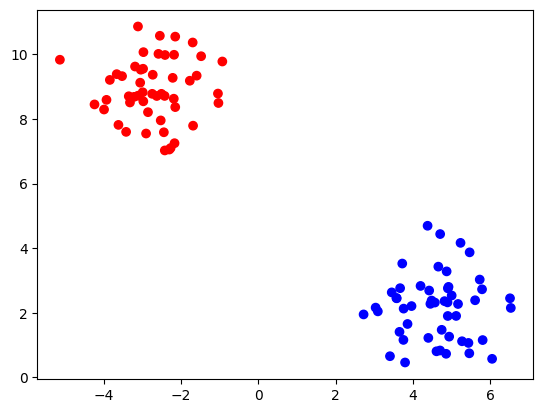

In [4]:
ppn = Perceptron(lr=0.1, epochs=10)
ppn.fit(X, y)

# Step 5: Setup the plot
fig, ax = plt.subplots()
colors = ['red' if label == -1 else 'blue' for label in y]
ax.scatter(X[:, 0], X[:, 1], c=colors)

line, = ax.plot([], [], 'k-', lw=2)

def init():
    line.set_data([], [])
    return line,

def update(frame):
    w, b = ppn.history[frame]
    x_vals = np.array(ax.get_xlim())
    y_vals = -(w[0] * x_vals + b) / w[1]
    line.set_data(x_vals, y_vals)
    return line,

In [5]:
anim = FuncAnimation(fig, update, frames=len(ppn.history), init_func=init,
                     blit=True, repeat=False)

plt.close()
HTML(anim.to_jshtml())